<a href="https://colab.research.google.com/github/santhiravuri/generative-ai-internship/blob/main/day8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms
from torchvision.utils import save_image, make_grid
from torch.utils.data import DataLoader
import os

In [ ]:
IMAGE_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 100
BATCH_SIZE = 128
NUM_EPOCHS = 50
LR = 2e-4  #0.0002
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
# ✅ Save directory for Colab
SAMPLE_DIR = "/content/samples"
os.makedirs(SAMPLE_DIR, exist_ok=True)

In [ ]:
class Generator(nn.Module):
    def __init__(self, z_dim):
        super(Generator, self).__init__()
        self.gen = nn.Sequential(
            nn.ConvTranspose2d(z_dim, 512, 4, 1, 0),
            nn.BatchNorm2d(512),
            nn.ReLU(True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1),
            nn.BatchNorm2d(128),
            nn.ReLU(True),

            nn.ConvTranspose2d(128, 64, 4, 2, 1),
            nn.BatchNorm2d(64),
            nn.ReLU(True),

            nn.ConvTranspose2d(64, CHANNELS_IMG, 4, 2, 1),
            nn.Tanh()
        )

    def forward(self, x):
        return self.gen(x)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            nn.Conv2d(CHANNELS_IMG, 64, 4, 2, 1),
            nn.LeakyReLU(0.2),

            nn.Conv2d(64, 128, 4, 2, 1),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.Conv2d(128, 256, 4, 2, 1),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),

            nn.Conv2d(256, 512, 4, 2, 1),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),

            nn.Conv2d(512, 1, 4, 1, 0),
            nn.Sigmoid()
        )

    def forward(self, x):
        return self.disc(x)

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.CenterCrop(IMAGE_SIZE),
    transforms.ToTensor(),
    transforms.Normalize([0.5]*3, [0.5]*3)
])

In [ ]:
dataloader = DataLoader(
    datasets.CIFAR10(root="data", train=True, download=True, transform=transform),
    batch_size=BATCH_SIZE, shuffle=True
)

100%|██████████| 170M/170M [00:04<00:00, 34.5MB/s]


Extracting data/cifar-10-python.tar.gz to data


In [ ]:
gen = Generator(Z_DIM).to(DEVICE)
disc = Discriminator().to(DEVICE)
gen.apply(weights_init)
disc.apply(weights_init)

Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1))
    (12): Sigmoid()
  )
)

In [ ]:
criterion = nn.BCELoss()
optimizer_gen = optim.Adam(gen.parameters(), lr=LR, betas=(0.5, 0.999))
optimizer_disc = optim.Adam(disc.parameters(), lr=LR, betas=(0.5, 0.999))


In [ ]:
fixed_noise = torch.randn(64, Z_DIM, 1, 1).to(DEVICE)

In [ ]:
print("🚀 Training Started...")
for epoch in range(NUM_EPOCHS):
    for i, (real, _) in enumerate(dataloader):
        real = real.to(DEVICE)
        batch_size = real.size(0)

        ### Train Discriminator
        noise = torch.randn(batch_size, Z_DIM, 1, 1).to(DEVICE)
        fake = gen(noise)

        disc_real = disc(real).reshape(-1)
        loss_real = criterion(disc_real, torch.ones_like(disc_real))

        disc_fake = disc(fake.detach()).reshape(-1)
        loss_fake = criterion(disc_fake, torch.zeros_like(disc_fake))

        loss_disc = (loss_real + loss_fake) / 2
        disc.zero_grad()
        loss_disc.backward()
        optimizer_disc.step()

        ### Train Generator
        output = disc(fake).reshape(-1)
        loss_gen = criterion(output, torch.ones_like(output))
        gen.zero_grad()
        loss_gen.backward()
        optimizer_gen.step()

        # Print progress
        if i % 100 == 0:
            print(f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {i}/{len(dataloader)} \
                  Loss D: {loss_disc:.4f}, loss G: {loss_gen:.4f}")

    # Save generated image samples
    with torch.no_grad():
        fake = gen(fixed_noise).detach().cpu()
    grid = make_grid(fake, nrow=8, normalize=True)
    save_image(grid, f"{SAMPLE_DIR}/epoch_{epoch}.png")

print("✅ Training Completed! Images saved to /samples/")

🚀 Training Started...
Epoch [0/50] Batch 0/391                   Loss D: 0.8014, loss G: 7.3543
Epoch [0/50] Batch 100/391                   Loss D: 0.2265, loss G: 4.4938
Epoch [0/50] Batch 200/391                   Loss D: 0.5881, loss G: 8.1652
Epoch [0/50] Batch 300/391                   Loss D: 0.4232, loss G: 2.1599
Epoch [1/50] Batch 0/391                   Loss D: 0.3777, loss G: 6.0913
Epoch [1/50] Batch 100/391                   Loss D: 0.1370, loss G: 2.7007
Epoch [1/50] Batch 200/391                   Loss D: 0.3425, loss G: 5.2297
Epoch [1/50] Batch 300/391                   Loss D: 0.2461, loss G: 2.9229
Epoch [2/50] Batch 0/391                   Loss D: 0.5775, loss G: 0.8908
Epoch [2/50] Batch 100/391                   Loss D: 0.4372, loss G: 1.8620
Epoch [2/50] Batch 200/391                   Loss D: 0.3221, loss G: 4.6866
Epoch [2/50] Batch 300/391                   Loss D: 0.2238, loss G: 2.9171
Epoch [3/50] Batch 0/391                   Loss D: 0.3239, loss G: 2.104

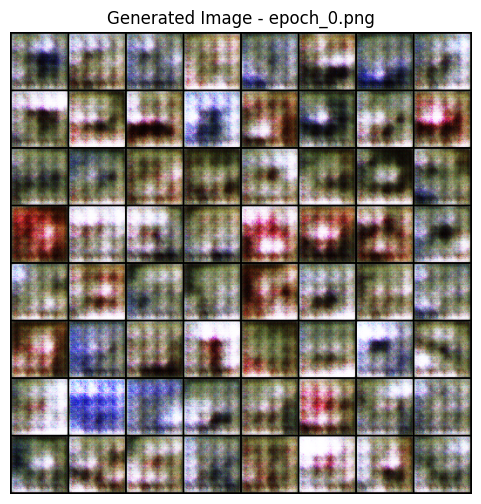

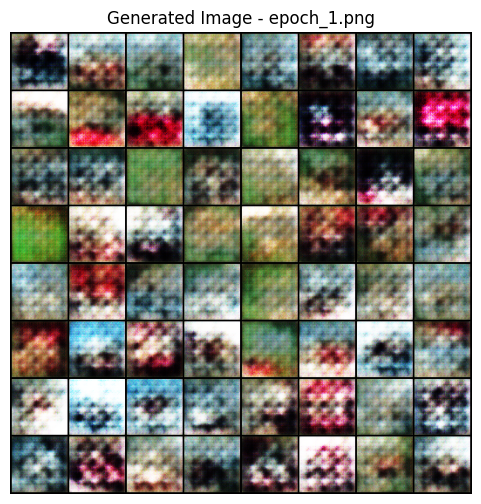

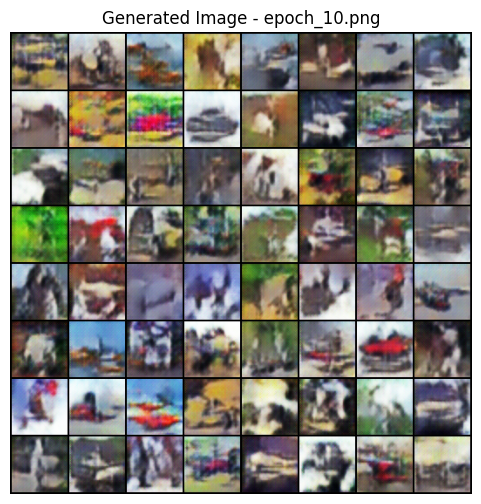

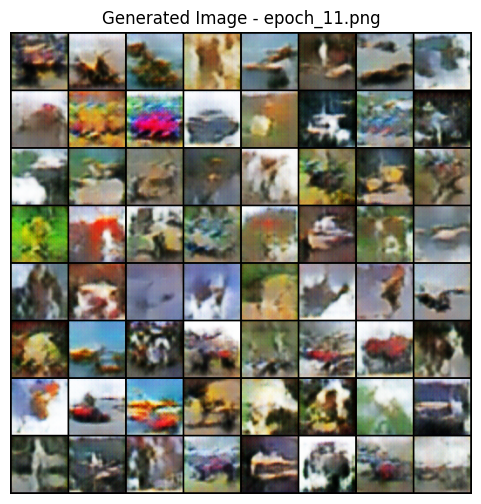

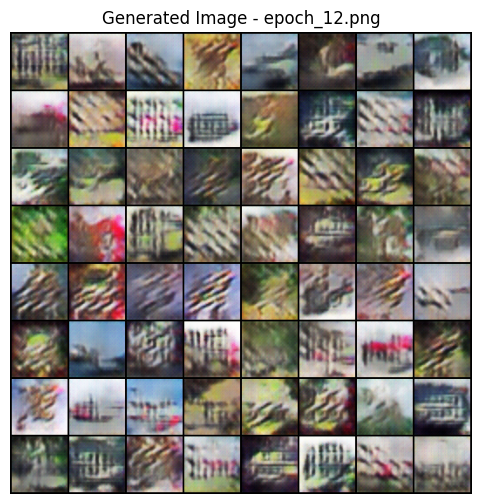

...

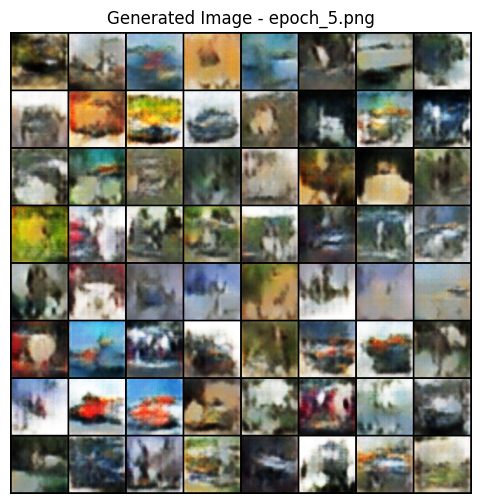

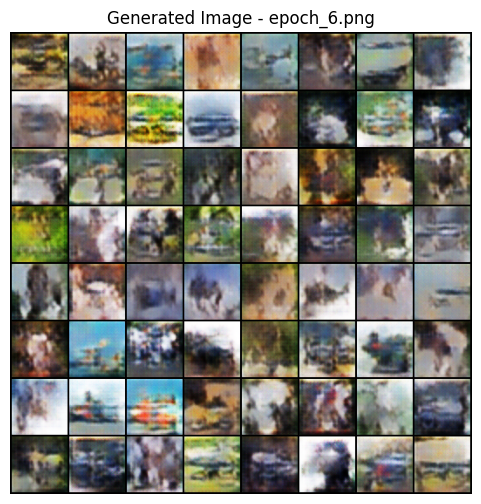

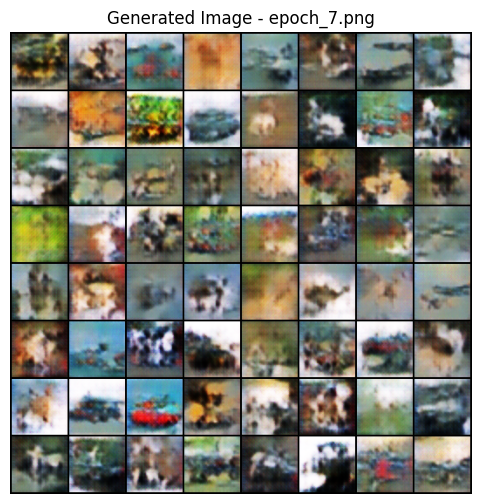

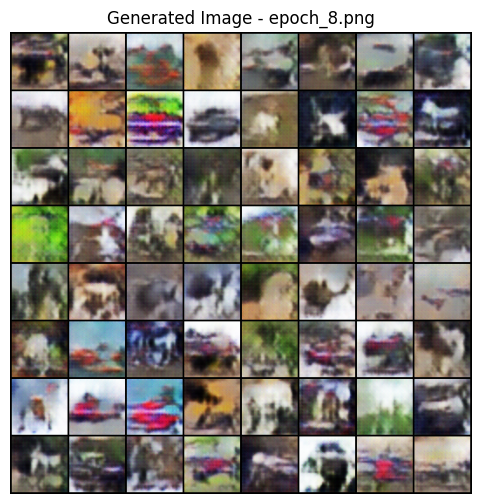

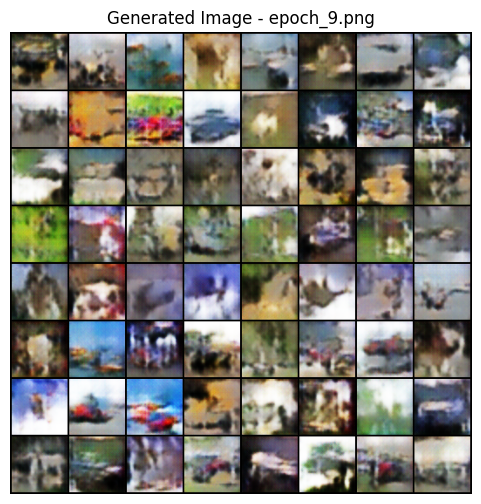

In [ ]:
# 📌 Display all generated images from each epoch
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob

# Get list of saved sample images
image_paths = sorted(glob.glob(f"{SAMPLE_DIR}/epoch_*.png"))

# Display images one by one
for path in image_paths:
    img = mpimg.imread(path)
    plt.figure(figsize=(6,6))
    plt.imshow(img)
    plt.axis("off")
    plt.title(f"Generated Image - {os.path.basename(path)}")
    plt.show()